from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
from matplotlib.colors import SymLogNorm
import matplotlib.colors as cm
from astropy.io import fits
from astropy.utils.data import get_pkg_data_filename
from astropy.wcs import WCS
from astropy import units as u
from astropy.wcs.utils import skycoord_to_pixel
#import aplpy

from matplotlib.gridspec import GridSpec
import astropy.io.fits as pyfits
from matplotlib.patches import Circle
from matplotlib.patches import Rectangle

from astropy.nddata import Cutout2D
from astropy.coordinates import SkyCoord
import matplotlib.colors as mc
from astropy.table import Table
import matplotlib as mpl

import skimage as ski
import skimage.measure as measure
from skimage.draw import polygon2mask


from astropy.convolution import Gaussian2DKernel

from scipy.signal import convolve as scipy_convolve
from astropy.convolution import convolve_fft
from scipy import ndimage, misc

from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.axes as maxes

from reproject import reproject_interp


In [4]:
###Import Maps###

herschel_fits=pyfits.open('/Users/danilipman/Documents/Research/UConn/3D_CMZ/FITS/column_properunits_conv36_source_only.fits')
herschel=herschel_fits[0].data
herschel_wcs = WCS(herschel_fits[0].header)


spitzer_fits=pyfits.open('/Users/danilipman/Documents/Research/UConn/3D_CMZ/FITS/GLM_00000+0000_mosaic_I4.fits')
spitzer=spitzer_fits[0].data
spitzer_wcs = WCS(spitzer_fits[0].header)

                        
temp_map_fits=pyfits.open('/Users/danilipman/Dropbox/plots_for_Cara/FITS/higalcmz_temperature_inner7deg.fits')
temp_map=temp_map_fits[0].data
temp_map_wcs = WCS(temp_map_fits[0].header)

temp_map_source_fits=pyfits.open('/Users/danilipman/Dropbox/plots_for_Cara/FITS/higalcmz_temperature_source_only_inner7deg.fits')
temp_map_source=temp_map_source_fits[0].data
temp_map_source_wcs = WCS(temp_map_source_fits[0].header)
                    

meerkat_fits = pyfits.open('/Users/danilipman/Dropbox/plots_for_Cara/FITS/MeerKAT_Galactic_Centre_1284MHz-StokesI_2D.fits')
meerkat = meerkat_fits[0].data
meerkat_wcs = WCS(meerkat_fits[0].header)

meerkat_reproj_fits = pyfits.open('/Users/danilipman/Dropbox/plots_for_Cara/FITS/meerkat_reprojected.fits')
meerkat_reproj = meerkat_reproj_fits[0].data
meerkat_reproj_wcs = WCS(meerkat_reproj_fits[0].header)



(322.5300028675, 510.19386617933606)

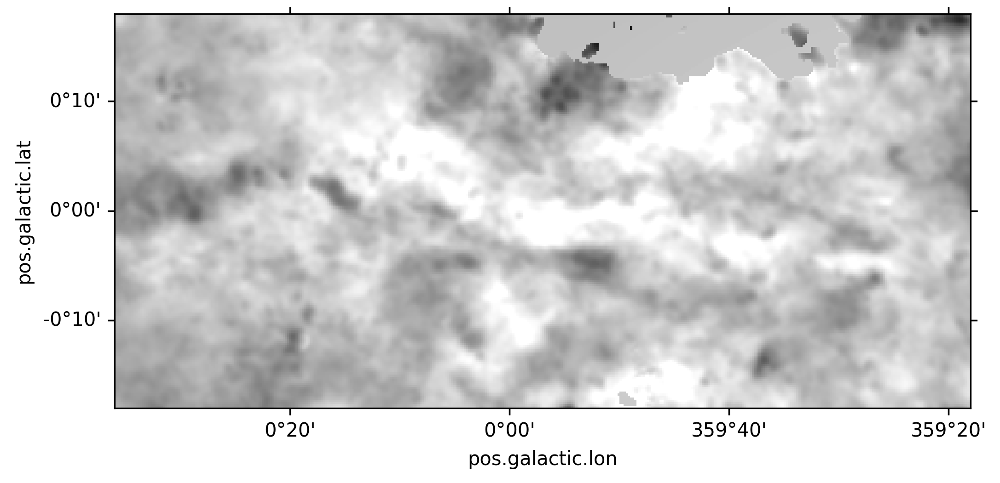

In [23]:
##Plot the temperature map##
fig, ax = plt.subplots(ncols= 1, subplot_kw={'projection': temp_map_wcs}, figsize = (8,8), dpi = 300)
temp_imshow = ax.imshow(temp_map, norm=LogNorm(vmin=13, vmax=32), origin='lower', cmap = 'gist_gray')

#extent of plot
ext_min = skycoord_to_pixel(SkyCoord(0.6, -0.3, unit="deg", frame='galactic'), temp_map_wcs)
ext_max = skycoord_to_pixel(SkyCoord(-0.7, 0.3, unit="deg", frame='galactic'), temp_map_wcs)

ax.set_xlim(ext_min[0],ext_max[0])
ax.set_ylim(ext_min[1],ext_max[1])

In [1]:
##smooth the temperature map to find contours for the bright region by the funnel

def gauss_smooth(hdu_map, r_eff, map_FWHM):
    # Make your Gaussian
    # sigma_gauss = sqrt( resolution you want^2 - resolution you have^2) = gaussian sigma
    # gaussian sigma / number of arcseconds per pixel = 2 pixels # Your number will be different
    res = r_eff/np.sqrt(2)
    test_res = res * 60 #arcmin * (60"/arcmin), want in arcseconds

    # sigma = FWHM/2.355
    map_sigma = map_FWHM/2.355 #temp map=36"

    sig_gauss = np.sqrt(test_res**2 - map_sigma**2 )
    kern = sig_gauss/(11) #arcsec/pix
    
    smoothed = convolve_fft(hdu_map, Gaussian2DKernel(x_stddev=kern), normalize_kernel=True, preserve_nan=True, allow_huge=True)
    return smoothed, kern


#pyfits.writeto('/Users/danilipman/Dropbox/plots_for_Cara/FITS/higalcmz_temperature_inner7deg_smoothed_{}arcmin.fits'.format(kern), smoothed, temp_map_fits[0].header, overwrite=True)


0
1
2
3


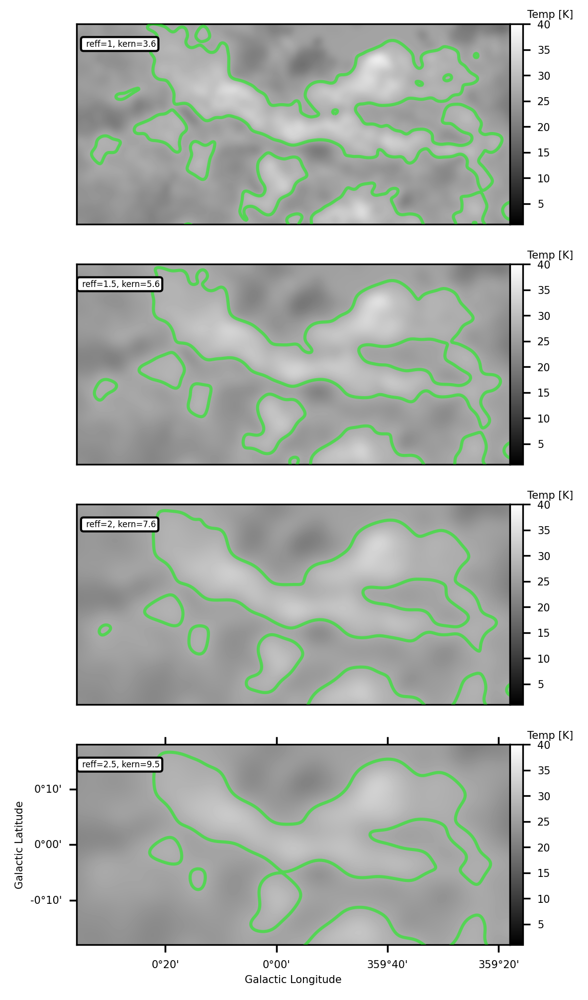

In [25]:
reff_list = [1,1.5,2,2.5]


fig, ax = plt.subplots(nrows=4 , subplot_kw={'projection': temp_map_wcs}, figsize = (8,8), dpi = 300)


for i in range(4):
    print(i)
    temp_smoothed, temp_kern = gauss_smooth(temp_map,reff_list[i],36)
    map_show = ax[i].imshow(temp_smoothed, vmin=1, vmax=40, origin='lower', cmap = 'gist_gray')
    ax[i].text(0.1, 0.90, r' reff={}, kern={:.1f}'.format(reff_list[i],temp_kern), ha='center', va='center', transform=ax[i].transAxes,
           bbox=dict(boxstyle = 'round', facecolor='white', edgecolor='k', alpha=1), fontsize=4)
    
    ax[i].contour(temp_smoothed, levels=np.linspace(4, 50, 5), colors='lime', alpha=0.5)

    ax[i].set_xlim(ext_min[0],ext_max[0])
    ax[i].set_ylim(ext_min[1],ext_max[1])
    
    divider = make_axes_locatable(ax[i])
    cax = divider.append_axes("right", size="3%", pad=0.0,  axes_class=maxes.Axes)
    cb = fig.colorbar(map_show, orientation="vertical", cax = cax )
    cb.set_label(label = r'Temp [K]', labelpad=0, y=1.07, rotation=0, fontsize = 5)
    cb.ax.tick_params(labelsize=5)


    if i<3: 
        ax[i].set_xlabel(' ')
        ax[i].tick_params(axis='x', bottom=False, labelbottom=False)
        ax[i].tick_params(axis='y', left=False, labelleft=False)
        
    if i==3:
        ax[i].set_ylabel('Galactic Latitude', fontsize=5)
        ax[i].set_xlabel('Galactic Longitude', fontsize=5)
        ax[i].tick_params(axis='x', labelsize=5)
        ax[i].tick_params(axis='y', labelsize=5)
        
plt.savefig('/Users/danilipman/Dropbox/plots_for_Cara/smoothing_tests.pdf',bbox_inches='tight')

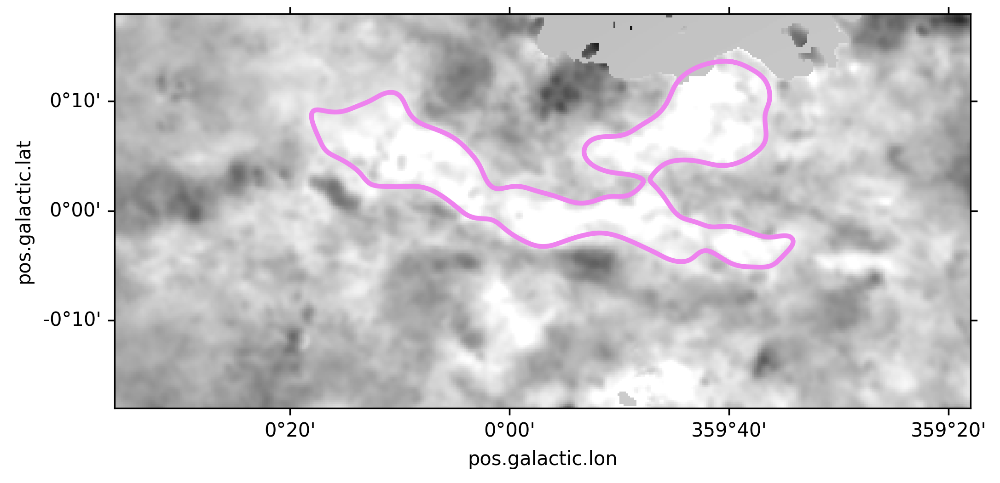

In [26]:
##Find contours for the reff=1.5 kernel 
temp_smoothed_1_5, temp_kern_1_5 = gauss_smooth(temp_map,1.5,36)

z = 8
c_temp = measure.find_contours(temp_smoothed_1_5,29)
x_cont= c_temp[z][:,1]
y_cont = c_temp[z][:,0]
lon10, lat10 = temp_map_wcs.wcs_pix2world(x_cont, y_cont, 0)


##Plot the temperature map##
fig, ax = plt.subplots(ncols= 1, subplot_kw={'projection': temp_map_wcs}, figsize = (8,8), dpi = 300)
temp_imshow = ax.imshow(temp_map, norm=LogNorm(vmin=13, vmax=32), origin='lower', cmap = 'gist_gray')
ax.plot(x_cont, y_cont, color='violet', transform=ax.get_transform(temp_map_wcs), linewidth=2.5)

#extent of plot
ext_min = skycoord_to_pixel(SkyCoord(0.6, -0.3, unit="deg", frame='galactic'), temp_map_wcs)
ext_max = skycoord_to_pixel(SkyCoord(-0.7, 0.3, unit="deg", frame='galactic'), temp_map_wcs)

ax.set_xlim(ext_min[0],ext_max[0])
ax.set_ylim(ext_min[1],ext_max[1])

plt.savefig('./29K.png')

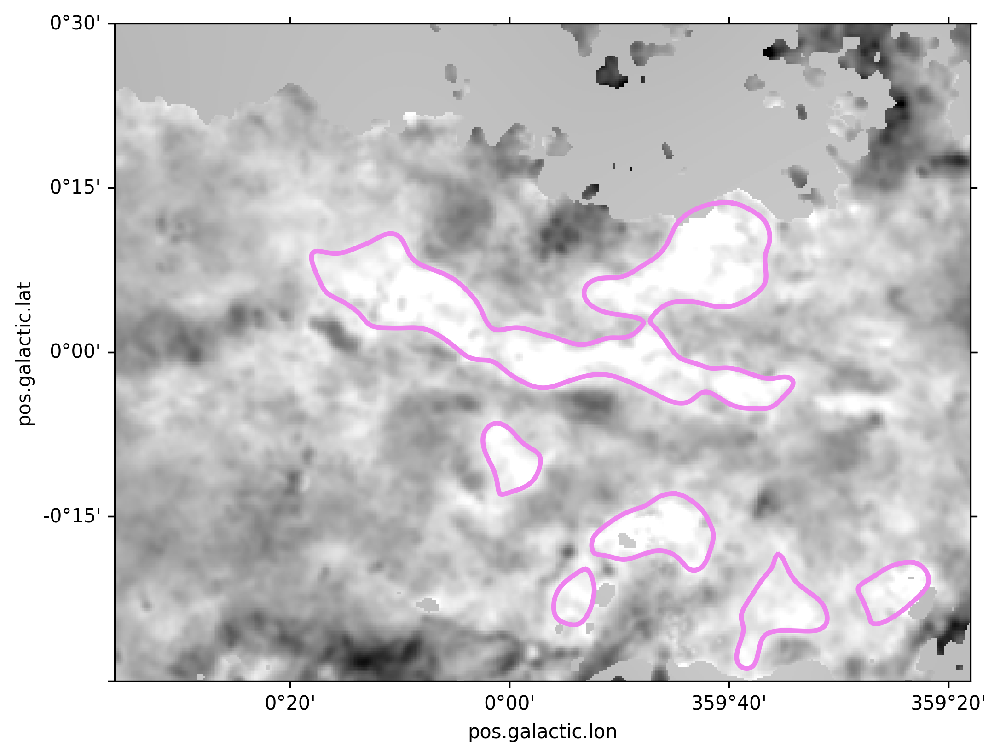

In [27]:
##Find contours for the reff=1.5 kernel 
temp_smoothed_1_5, temp_kern_1_5 = gauss_smooth(temp_map,1.5,36)




##Plot the temperature map##
fig, ax = plt.subplots(ncols= 1, subplot_kw={'projection': temp_map_wcs}, figsize = (8,8), dpi = 300)
temp_imshow = ax.imshow(temp_map, norm=LogNorm(vmin=13, vmax=32), origin='lower', cmap = 'gist_gray')

for z in [2,3,4,5,6,8]:

    c_temp = measure.find_contours(temp_smoothed_1_5,29)
    x_cont= c_temp[z][:,1]
    y_cont = c_temp[z][:,0]
    lon10, lat10 = temp_map_wcs.wcs_pix2world(x_cont, y_cont, 0)
    ax.plot(x_cont, y_cont, color='violet', transform=ax.get_transform(temp_map_wcs), linewidth=2.5)

#extent of plot
ext_min = skycoord_to_pixel(SkyCoord(.6, -0.5, unit="deg", frame='galactic'), temp_map_wcs)
ext_max = skycoord_to_pixel(SkyCoord(-.7, 0.5, unit="deg", frame='galactic'), temp_map_wcs)

ax.set_xlim(ext_min[0],ext_max[0])
ax.set_ylim(ext_min[1],ext_max[1])

plt.savefig('./29K_all.png', bbox_inches='tight')



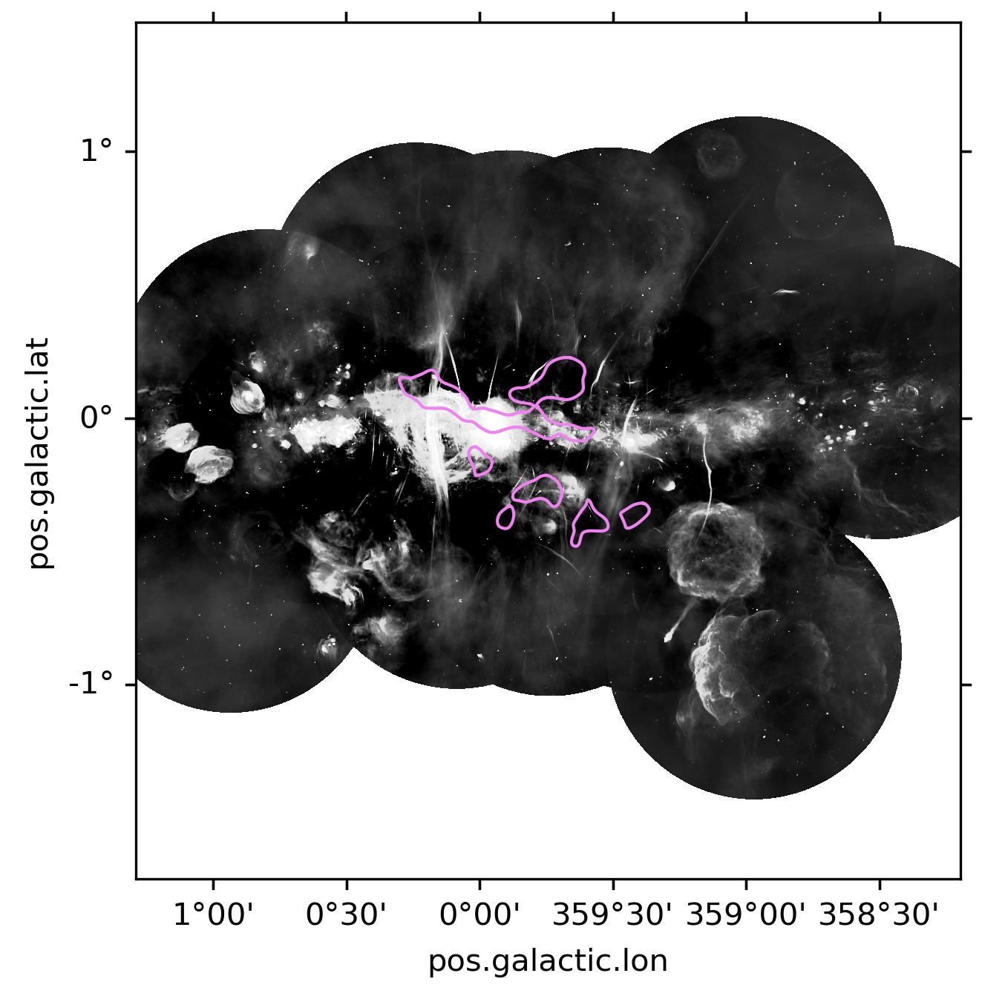

In [9]:
##Plot the meerkat map##
fig, ax = plt.subplots(ncols= 1, subplot_kw={'projection': meerkat_reproj_wcs}, figsize = (5,5), dpi = 300)
meerkat_reproj_image = ax.imshow(meerkat_reproj, norm=cm.SymLogNorm(linthresh=0.0005, linscale=5, vmin=-0.0001, vmax=0.01), origin='lower', cmap = 'gist_gray')
for z in [2,3,4,5,6,8]:

    c_temp = measure.find_contours(temp_smoothed_1_5,29)
    x_cont= c_temp[z][:,1]
    y_cont = c_temp[z][:,0]
    lon10, lat10 = temp_map_wcs.wcs_pix2world(x_cont, y_cont, 0)
    ax.plot(x_cont, y_cont, color='violet', transform=ax.get_transform(temp_map_wcs), linewidth=1)

plt.savefig('./29K_meerkat_all.png', bbox_inches='tight')

In [10]:
meerkat_fits[0].header

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                  -64 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
NAXIS1  =                10121                                                  
NAXIS2  =                10527                                                  
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
COMMENT   -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-                           
COMMENT   MeerKAT Galactic Centre Survey                                        
COMMENT   South African Radio Astronomy Observatory                             
COMMENT   Total intensity mosaic                                                
COMMENT   Contact: ian.heywood@physics.ox.ac.uk                                 
COMMENT   -=-=-=-=-=-=-=-=-=

In [11]:
gc = SkyCoord(ra=266.366790598*u.degree, dec=-29.2213778092*u.degree, frame='fk5')
gc.galactic

###find new center pixel in galactic and then save a new fits header to use reproject with?

<SkyCoord (Galactic): (l, b) in deg
    (359.73918811, -0.12014267)>

In [12]:
hdu_new = fits.PrimaryHDU(data=meerkat)

header = hdu_new.header
header.set('ctype1',"GLON-TAN")
header.set('crval1', 359.73918811)
header.set('cdelt1', meerkat_fits[0].header['CDELT1'] )
header.set('crpix1',meerkat_fits[0].header['CRPIX1'])
header.set('cunit1',"deg" )
header.set('ctype2',"GLAT-TAN")
header.set('crval2', -0.12014267)
header.set('cdelt2', meerkat_fits[0].header['CDELT2'])
header.set('crpix2', meerkat_fits[0].header['CRPIX2'])
header.set('cunit2', "deg")

#array, footprint = reproject_interp(meerkat_fits, hdu_new.header)
#fits.writeto('meerkat_reprojected.fits', array, hdu_new.header, overwrite=True)

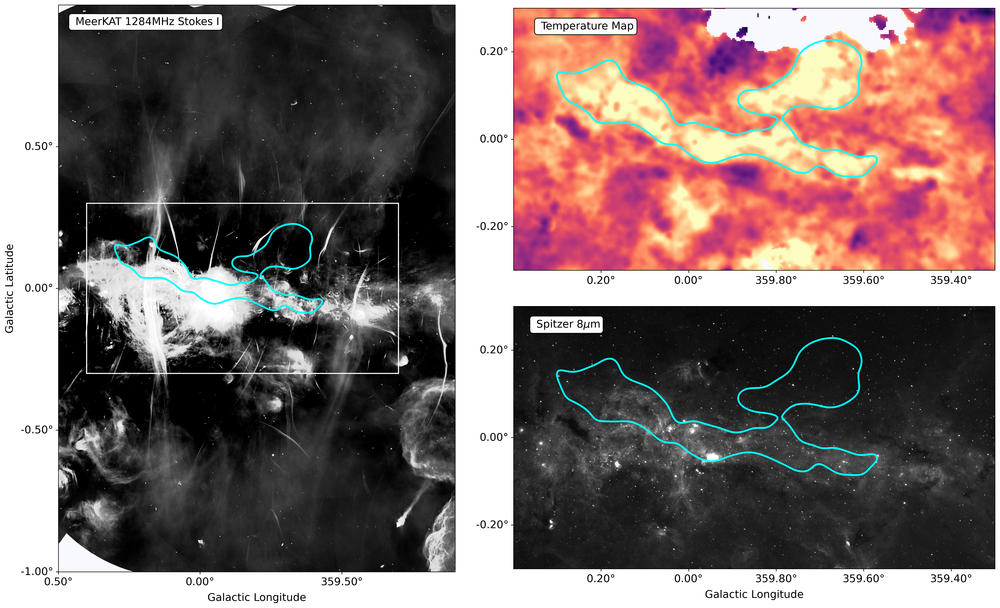

In [13]:
###Now make nice plot with Meerkat, col den, and temp map!###

plt.rcParams.update({"axes.facecolor" : "ghostwhite"}) 

fxsz = 40
xyrat = 2./8.
fysz = fxsz * xyrat
ds = 0.01
fig = plt.figure( figsize=(20,12), dpi=300)
gs = GridSpec(20,31)
gs.update(left=ds, right=1-ds, bottom=ds, top=1-ds, hspace=0, wspace=0)


axes1 = plt.subplot(gs[1:20, 1:15], projection=meerkat_reproj_wcs) #meerkat
axes2 = plt.subplot(gs[1:10, 16:], projection=temp_map_source_wcs)  #temp
axes3 = plt.subplot(gs[11:, 16:], projection = spitzer_wcs)   #spitz

z=8
c_temp = measure.find_contours(temp_smoothed_1_5,29)
x_cont= c_temp[z][:,1]
y_cont = c_temp[z][:,0]
lon10, lat10 = temp_map_wcs.wcs_pix2world(x_cont, y_cont, 0)
ax.plot(x_cont, y_cont, color='violet', transform=ax.get_transform(temp_map_wcs), linewidth=1)

axes1.imshow(meerkat_reproj,norm=cm.SymLogNorm(linthresh=0.0005, linscale=5, vmin=-0.0001, vmax=0.01), origin='lower', cmap = 'gray')
#axes1.imshow(meerkat_reproj,norm=cm.SymLogNorm(linthresh=0.001, linscale=4, vmin=-0.0004, vmax=0.35), origin='lower', cmap = 'gray')
axes1.plot(x_cont, y_cont, color='cyan', transform=axes1.get_transform(temp_map_wcs), linewidth=2.5)
ext_min_1 = skycoord_to_pixel(SkyCoord(0.5, -1, unit="deg", frame='galactic'), meerkat_reproj_wcs)
ext_max_1 = skycoord_to_pixel(SkyCoord(-0.9, 1, unit="deg", frame='galactic'), meerkat_reproj_wcs)
axes1.set_xlim(ext_min_1[0],ext_max_1[0])
axes1.set_ylim(ext_min_1[1],ext_max_1[1])
axes1.text(0.22, 0.97, r' MeerKAT 1284MHz Stokes I', ha='center', va='center', transform=axes1.transAxes,
           bbox=dict(boxstyle = 'round', facecolor='white', edgecolor='k', alpha=1), fontsize=15)




lon = axes1.coords[0]
lat = axes1.coords[1]

lon.set_major_formatter('d.dd')
lat.set_major_formatter('d.dd')

axes1.set_ylabel('Galactic Latitude', fontsize=15)
axes1.set_xlabel('Galactic Longitude', fontsize=15)
axes1.tick_params(axis='x', labelsize=15)
axes1.tick_params(axis='y', labelsize=15)

lon.set_ticks_position('b')
lon.set_ticklabel_position('b')
lon.set_axislabel_position('b')
lat.set_ticks_position('l')
lat.set_ticklabel_position('l')
lat.set_axislabel_position('l')






axes2.imshow(temp_map_source, vmin=13,vmax=32, origin='lower', cmap = 'magma')
axes2.plot(x_cont, y_cont, color='cyan', transform=axes2.get_transform(temp_map_source_wcs), linewidth=2.5)
ext_min = skycoord_to_pixel(SkyCoord(0.4, -0.3, unit="deg", frame='galactic'), temp_map_wcs)
ext_max = skycoord_to_pixel(SkyCoord(-0.7, 0.3, unit="deg", frame='galactic'), temp_map_wcs)
axes2.set_xlim(ext_min[0],ext_max[0])
axes2.set_ylim(ext_min[1],ext_max[1])
axes2.text(0.15, 0.93, r' Temperature Map', ha='center', va='center', transform=axes2.transAxes,
           bbox=dict(boxstyle = 'round', facecolor='white', edgecolor='k', alpha=1), fontsize=15)


lon = axes2.coords[0]
lat = axes2.coords[1]

lon.set_major_formatter('d.dd')
lat.set_major_formatter('d.dd')

axes2.set_ylabel(' ')
axes2.set_xlabel(' ')
axes2.tick_params(axis='x', bottom=False, labelbottom=False, right=False)
#axes2.set_yticks([-0.20, 0.00, 0.20])
axes2.tick_params(axis='y' , labelsize=15)
axes2.tick_params(axis='x' , labelsize=15)

lon.set_ticks_position('b')
lon.set_ticklabel_position('b')
lon.set_axislabel_position('b')
lat.set_ticks_position('l')
lat.set_ticklabel_position('l')
lat.set_axislabel_position('l')




axes3.imshow(spitzer, vmin=0, vmax=1300, origin='lower', cmap = 'gray')
axes3.plot(x_cont, y_cont, color='cyan', transform=axes3.get_transform(temp_map_wcs), linewidth=2.5)
ext_min = skycoord_to_pixel(SkyCoord(0.4, -0.3, unit="deg", frame='galactic'), spitzer_wcs)
ext_max = skycoord_to_pixel(SkyCoord(-0.7, 0.3, unit="deg", frame='galactic'), spitzer_wcs)
axes3.set_xlim(ext_min[0],ext_max[0])
axes3.set_ylim(ext_min[1],ext_max[1])
axes3.text(0.11, 0.93, r' Spitzer 8$\mu$m', ha='center', va='center', transform=axes3.transAxes,
           bbox=dict(boxstyle = 'round', facecolor='white', edgecolor='k', alpha=1), fontsize=15)


#axes3.imshow(herschel, norm=cm.LogNorm(vmin=1e20, vmax=2e23), origin='lower', cmap = 'magma')
#axes3.plot(x_cont, y_cont, color='cyan', transform=axes3.get_transform(temp_map_wcs), linewidth=2.5)
#ext_min = skycoord_to_pixel(SkyCoord(0.4, -0.3, unit="deg", frame='galactic'), herschel_wcs)
#ext_max = skycoord_to_pixel(SkyCoord(-0.7, 0.3, unit="deg", frame='galactic'), herschel_wcs)
#axes3.set_xlim(ext_min[0],ext_max[0])
#axes3.set_ylim(ext_min[1],ext_max[1])
#axes3.text(0.13, 0.93, r' Herschel Col Den', ha='center', va='center', transform=axes3.transAxes,
#           bbox=dict(boxstyle = 'round', facecolor='white', edgecolor='k', alpha=1), fontsize=15)

lon = axes3.coords[0]
lat = axes3.coords[1]

lon.set_major_formatter('d.dd')
lat.set_major_formatter('d.dd')
axes3.set_ylabel(' ')
axes3.set_xlabel('Galactic Longitude', fontsize=15)
axes3.tick_params(axis='x', labelsize=15)
axes3.tick_params(axis='y', labelsize=15)


lon.set_ticks_position('b')
lon.set_ticklabel_position('b')
lon.set_axislabel_position('b')
lat.set_ticks_position('l')
lat.set_ticklabel_position('l')
lat.set_axislabel_position('l')



#make box around zoomed region in meerkat

ext_min_zoom = skycoord_to_pixel(SkyCoord(0.4, -0.3, unit="deg", frame='galactic'), meerkat_reproj_wcs)
ext_max_zoom = skycoord_to_pixel(SkyCoord(-0.7, 0.3, unit="deg", frame='galactic'), meerkat_reproj_wcs)
rect = Rectangle((ext_min_zoom[0], ext_min_zoom[1]), ext_max_zoom[0]-ext_min_zoom[0]  , ext_max_zoom[1]-ext_min_zoom[1], 
                 linewidth=1.5, edgecolor='white', facecolor='none')
# Add the patch to the Axes
axes1.add_patch(rect)


#plt.tight_layout()

plt.savefig('/Users/danilipman/Dropbox/plots_for_Cara/plots_and_figures_for_Cara/meerkat_temp_den_plot.pdf',bbox_inches='tight')


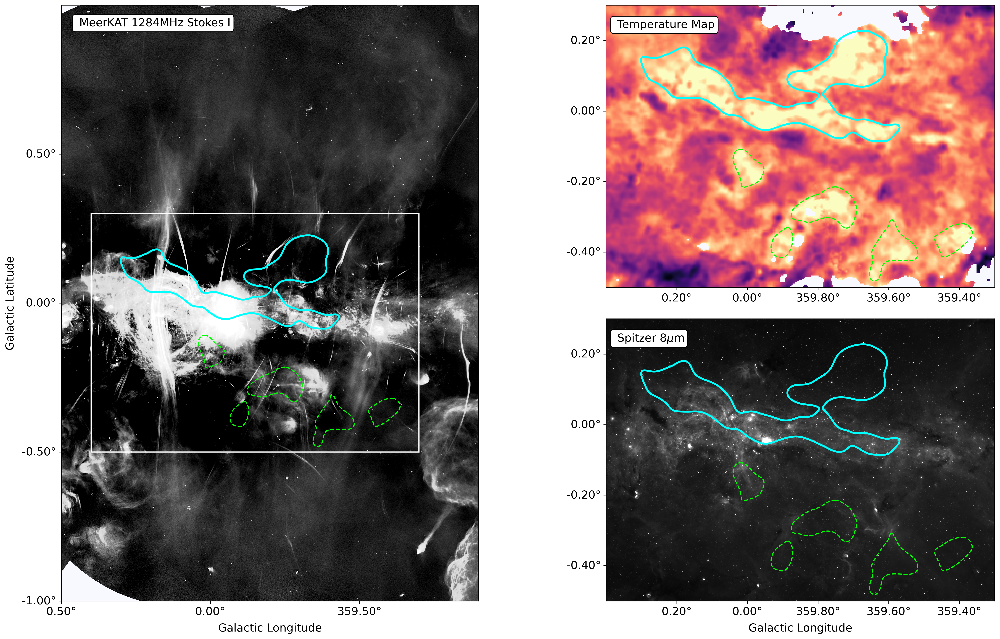

In [15]:
###Now make nice plot with Meerkat, col den, and temp map!###

plt.rcParams.update({"axes.facecolor" : "ghostwhite"}) 

fxsz = 40
xyrat = 2./8.
fysz = fxsz * xyrat
ds = 0.01
fig = plt.figure( figsize=(20,12), dpi=300)
gs = GridSpec(20,31)
gs.update(left=ds, right=1-ds, bottom=ds, top=1-ds, hspace=0, wspace=0.75)


axes1 = plt.subplot(gs[1:20, 1:15], projection=meerkat_reproj_wcs) #meerkat
axes2 = plt.subplot(gs[1:10, 16:], projection=temp_map_source_wcs)  #temp
axes3 = plt.subplot(gs[11:, 16:], projection = spitzer_wcs)   #spitz


axes1.imshow(meerkat_reproj,norm=cm.SymLogNorm(linthresh=0.0005, linscale=5, vmin=-0.0001, vmax=0.01), origin='lower', cmap = 'gray')
#axes1.imshow(meerkat_reproj,norm=cm.SymLogNorm(linthresh=0.001, linscale=4, vmin=-0.0004, vmax=0.35), origin='lower', cmap = 'gray')
for z in [2,3,4,5,6,8]:
    c_temp = measure.find_contours(temp_smoothed_1_5,29)
    x_cont= c_temp[z][:,1]
    y_cont = c_temp[z][:,0]
    lon10, lat10 = temp_map_wcs.wcs_pix2world(x_cont, y_cont, 0)
    if z==8:
        axes1.plot(x_cont, y_cont, color='cyan', transform=axes1.get_transform(temp_map_wcs), linewidth=2.5)
    else:
        axes1.plot(x_cont, y_cont, color='lime', transform=axes1.get_transform(temp_map_wcs), linewidth=1.5, linestyle = '--')
ext_min_1 = skycoord_to_pixel(SkyCoord(0.5, -1, unit="deg", frame='galactic'), meerkat_reproj_wcs)
ext_max_1 = skycoord_to_pixel(SkyCoord(-0.9, 1, unit="deg", frame='galactic'), meerkat_reproj_wcs)
axes1.set_xlim(ext_min_1[0],ext_max_1[0])
axes1.set_ylim(ext_min_1[1],ext_max_1[1])
axes1.text(0.22, 0.97, r' MeerKAT 1284MHz Stokes I', ha='center', va='center', transform=axes1.transAxes,
           bbox=dict(boxstyle = 'round', facecolor='white', edgecolor='k', alpha=1), fontsize=15)




lon = axes1.coords[0]
lat = axes1.coords[1]

lon.set_major_formatter('d.dd')
lat.set_major_formatter('d.dd')

axes1.set_ylabel('Galactic Latitude', fontsize=15)
axes1.set_xlabel('Galactic Longitude', fontsize=15)
axes1.tick_params(axis='x', labelsize=15)
axes1.tick_params(axis='y', labelsize=15)

lon.set_ticks_position('b')
lon.set_ticklabel_position('b')
lon.set_axislabel_position('b')
lat.set_ticks_position('l')
lat.set_ticklabel_position('l')
lat.set_axislabel_position('l')





axes2.imshow(temp_map_source, vmin=13,vmax=32, origin='lower', cmap = 'magma')
for z in [2,3,4,5,6,8]:
    c_temp = measure.find_contours(temp_smoothed_1_5,29)
    x_cont= c_temp[z][:,1]
    y_cont = c_temp[z][:,0]
    lon10, lat10 = temp_map_wcs.wcs_pix2world(x_cont, y_cont, 0)
    if z==8:
        axes2.plot(x_cont, y_cont, color='cyan', transform=axes2.get_transform(temp_map_wcs), linewidth=2.5)
    else:
        axes2.plot(x_cont, y_cont, color='lime', transform=axes2.get_transform(temp_map_wcs), linewidth=1.5, linestyle = '--')
ext_min = skycoord_to_pixel(SkyCoord(.4, -0.5, unit="deg", frame='galactic'), temp_map_wcs)
ext_max = skycoord_to_pixel(SkyCoord(-.7, 0.3, unit="deg", frame='galactic'), temp_map_wcs)
axes2.set_xlim(ext_min[0],ext_max[0])
axes2.set_ylim(ext_min[1],ext_max[1])
axes2.text(0.15, 0.93, r' Temperature Map', ha='center', va='center', transform=axes2.transAxes,
           bbox=dict(boxstyle = 'round', facecolor='white', edgecolor='k', alpha=1), fontsize=15)


lon = axes2.coords[0]
lat = axes2.coords[1]

lon.set_major_formatter('d.dd')
lat.set_major_formatter('d.dd')

axes2.set_ylabel(' ')
axes2.set_xlabel(' ')
axes2.tick_params(axis='x', bottom=False, labelbottom=False, right=False)
#axes2.set_yticks([-0.20, 0.00, 0.20])
axes2.tick_params(axis='y' , labelsize=15)
axes2.tick_params(axis='x' , labelsize=15)

lon.set_ticks_position('b')
lon.set_ticklabel_position('b')
lon.set_axislabel_position('b')
lat.set_ticks_position('l')
lat.set_ticklabel_position('l')
lat.set_axislabel_position('l')




axes3.imshow(spitzer, vmin=0, vmax=1300, origin='lower', cmap = 'gray')
for z in [2,3,4,5,6,8]:
    c_temp = measure.find_contours(temp_smoothed_1_5,29)
    x_cont= c_temp[z][:,1]
    y_cont = c_temp[z][:,0]
    lon10, lat10 = temp_map_wcs.wcs_pix2world(x_cont, y_cont, 0)
    if z==8:
        axes3.plot(x_cont, y_cont, color='cyan', transform=axes3.get_transform(temp_map_wcs), linewidth=2.5)
    else:
        axes3.plot(x_cont, y_cont, color='lime', transform=axes3.get_transform(temp_map_wcs), linewidth=1.5, linestyle = '--')
ext_min = skycoord_to_pixel(SkyCoord(.4, -0.5, unit="deg", frame='galactic'), spitzer_wcs)
ext_max = skycoord_to_pixel(SkyCoord(-.7, 0.3, unit="deg", frame='galactic'), spitzer_wcs)
axes3.set_xlim(ext_min[0],ext_max[0])
axes3.set_ylim(ext_min[1],ext_max[1])
axes3.text(0.11, 0.93, r' Spitzer 8$\mu$m', ha='center', va='center', transform=axes3.transAxes,
           bbox=dict(boxstyle = 'round', facecolor='white', edgecolor='k', alpha=1), fontsize=15)



lon = axes3.coords[0]
lat = axes3.coords[1]

lon.set_major_formatter('d.dd')
lat.set_major_formatter('d.dd')
axes3.set_ylabel(' ')
axes3.set_xlabel('Galactic Longitude', fontsize=15)
axes3.tick_params(axis='x', labelsize=15)
axes3.tick_params(axis='y', labelsize=15)


lon.set_ticks_position('b')
lon.set_ticklabel_position('b')
lon.set_axislabel_position('b')
lat.set_ticks_position('l')
lat.set_ticklabel_position('l')
lat.set_axislabel_position('l')



#make box around zoomed region in meerkat

ext_min_zoom = skycoord_to_pixel(SkyCoord(.4, -0.5, unit="deg", frame='galactic'), meerkat_reproj_wcs)
ext_max_zoom = skycoord_to_pixel(SkyCoord(-.7, 0.3, unit="deg", frame='galactic'), meerkat_reproj_wcs)
rect = Rectangle((ext_min_zoom[0], ext_min_zoom[1]), ext_max_zoom[0]-ext_min_zoom[0]  , ext_max_zoom[1]-ext_min_zoom[1], 
                 linewidth=1.5, edgecolor='white', facecolor='none')
# Add the patch to the Axes
axes1.add_patch(rect)


#plt.tight_layout()

plt.savefig('/Users/danilipman/Dropbox/plots_for_Cara/plots_and_figures_for_Cara/meerkat_temp_den_plot_central.pdf',bbox_inches='tight')
